# Street Network

Placing crime on street segments...

In [2]:
%load_ext autoreload
%autoreload 2

In [20]:
import geopandas as gpd
import numpy as np
import osmnx as ox
import pandas as pd
from shapely import Point

from utils import extract_crime_data, get_neighbourhood_boundaries

In [5]:
FORCE = "west-yorkshire"
neighbourhood_boundaries = get_neighbourhood_boundaries(FORCE)
neighbourhood_boundaries

,name,geometry
BDT_BE,Bradford East,"POLYGON ((416638.358 430321.317, 416652.358 43..."
BDT_BS,Bradford South,"POLYGON ((417489.845 427900.102, 417555.55 427..."
BDT_BW,Bradford West,"POLYGON ((413804.493 433227.937, 413874.987 43..."
BDT_CI,Bradford City,"POLYGON ((416456.604 434055.59, 416502.307 434..."
BDT_KE,Keighley,"POLYGON ((404908.392 432356.233, 404903.296 43..."
BDT_SH,Shipley,"POLYGON ((412728.966 436521.65, 412759.255 436..."
CDT_HX,Halifax,"POLYGON ((408152.08 422797.025, 408165.281 422..."
CDT_VL,Calderdale Valleys,"POLYGON ((396351.604 420735.748, 396352.899 42..."
KDT_BS,Batley and Spen,"POLYGON ((424358.794 426110.873, 424361.499 42..."
KDT_DEW,Dewsbury,"POLYGON ((425514.816 420194.301, 425547.821 42..."


In [6]:
crime_data = extract_crime_data("./data/wy202404-202503.zip")
crime_data = crime_data[crime_data.geometry.intersects(neighbourhood_boundaries.loc["BDT_KE"].geometry)]
crime_data

,Month,Reported by,Falls within,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context,Outcome type,geometry
Crime ID,,,,,,,,,,,
f3dc2030833b0bc107bc49bfc5182a73b95644e5ed7b3c2674665a880527f710,2024-04,West Yorkshire Police,West Yorkshire Police,On or near Park Crescent,E01010646,Bradford 001A,Burglary,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (408134.024 449714.037)
9b7f1084be073130cca59d4dfc1cc1cb7fd7909f7c78bbd2d795685831278e51,2024-04,West Yorkshire Police,West Yorkshire Police,On or near Sycamore Drive,E01010646,Bradford 001A,Criminal damage and arson,Unable to prosecute suspect,NaN,Unable to prosecute suspect,POINT (408279.985 449615.044)
e5c5cd14ee4578b58ac1aa079623223e35e48ad173075db6bafda1869eaae743,2024-04,West Yorkshire Police,West Yorkshire Police,On or near Parking Area,E01010646,Bradford 001A,Other theft,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (407833.974 449797.978)
940f27f2e576bd235c4796da99a4ac361d938e7d7e68273950d549a61c1b7d5c,2024-04,West Yorkshire Police,West Yorkshire Police,On or near North Street,E01010646,Bradford 001A,Public order,Unable to prosecute suspect,NaN,Unable to prosecute suspect,POINT (408339.983 449763.018)
9e50f5eed93e2432156623636e67b80b48d59637c5f0769ea6cb08c7e19c12a3,2024-04,West Yorkshire Police,West Yorkshire Police,On or near Croft House Fold,E01010646,Bradford 001A,Vehicle crime,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (408215.994 449646.976)
...,...,...,...,...,...,...,...,...,...,...,...
5f70443c14fddf679d1f7e67d66e850725429915a953aaa603db94f59e0029cf,2025-03,West Yorkshire Police,West Yorkshire Police,On or near Craven Avenue,E01010639,Bradford 063C,Burglary,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (404473.013 446265.035)
14805f3b4bf2ea470271aa6b77957992bb0d2d295aca9b4c7b8dc8483c401a6b,2025-03,West Yorkshire Police,West Yorkshire Police,On or near The Mallards,E01010639,Bradford 063C,Criminal damage and arson,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (404304.97 446058.045)
b91ac4982c507208a859ceeb527236dac35e2abfe79225c0797b5664c8e82d21,2025-03,West Yorkshire Police,West Yorkshire Police,On or near Low House Drive,E01010639,Bradford 063C,Criminal damage and arson,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (404264.97 445903.021)


In [7]:
# get street network in lon-lat polygon then project back to BNG
G = ox.graph_from_polygon(neighbourhood_boundaries.to_crs(epsg=4326).loc["BDT_KE"].geometry, network_type="drive")
G = ox.project_graph(G, to_crs="epsg:27700")
_nodes, street_segments = ox.graph_to_gdfs(G)

In [8]:
map = street_segments.explore(tiles="CartoDB positron", color="black")
map = crime_data.explore("Crime type", m=map)
map

In [9]:
# TODO is there a faster/better way
def snap_to_street_segment(point: Point, street_segments: gpd.GeoDataFrame):
    distances = street_segments.distance(point)
    return pd.Series({"street_segment": distances.idxmin(), "distance": distances.min()})


crime_data[["street_segment", "distance"]] = crime_data.geometry.apply(
    lambda p: snap_to_street_segment(p, street_segments)
)
crime_data

,Month,Reported by,Falls within,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context,Outcome type,geometry,street_segment,distance
Crime ID,,,,,,,,,,,,,
f3dc2030833b0bc107bc49bfc5182a73b95644e5ed7b3c2674665a880527f710,2024-04,West Yorkshire Police,West Yorkshire Police,On or near Park Crescent,E01010646,Bradford 001A,Burglary,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (408134.024 449714.037),"(1002560501, 1002560497, 0)",0.237680
9b7f1084be073130cca59d4dfc1cc1cb7fd7909f7c78bbd2d795685831278e51,2024-04,West Yorkshire Police,West Yorkshire Police,On or near Sycamore Drive,E01010646,Bradford 001A,Criminal damage and arson,Unable to prosecute suspect,NaN,Unable to prosecute suspect,POINT (408279.985 449615.044),"(33075664, 1002561718, 0)",1.224454
e5c5cd14ee4578b58ac1aa079623223e35e48ad173075db6bafda1869eaae743,2024-04,West Yorkshire Police,West Yorkshire Police,On or near Parking Area,E01010646,Bradford 001A,Other theft,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (407833.974 449797.978),"(28322295, 2200772649, 0)",11.802124
940f27f2e576bd235c4796da99a4ac361d938e7d7e68273950d549a61c1b7d5c,2024-04,West Yorkshire Police,West Yorkshire Police,On or near North Street,E01010646,Bradford 001A,Public order,Unable to prosecute suspect,NaN,Unable to prosecute suspect,POINT (408339.983 449763.018),"(767963519, 27370248, 0)",0.677527
9e50f5eed93e2432156623636e67b80b48d59637c5f0769ea6cb08c7e19c12a3,2024-04,West Yorkshire Police,West Yorkshire Police,On or near Croft House Fold,E01010646,Bradford 001A,Vehicle crime,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (408215.994 449646.976),"(2200772823, 2200772689, 0)",2.324149
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5f70443c14fddf679d1f7e67d66e850725429915a953aaa603db94f59e0029cf,2025-03,West Yorkshire Police,West Yorkshire Police,On or near Craven Avenue,E01010639,Bradford 063C,Burglary,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (404473.013 446265.035),"(1600140457, 1600140456, 0)",0.326739
14805f3b4bf2ea470271aa6b77957992bb0d2d295aca9b4c7b8dc8483c401a6b,2025-03,West Yorkshire Police,West Yorkshire Police,On or near The Mallards,E01010639,Bradford 063C,Criminal damage and arson,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (404304.97 446058.045),"(1600101894, 1600101906, 0)",0.684572
b91ac4982c507208a859ceeb527236dac35e2abfe79225c0797b5664c8e82d21,2025-03,West Yorkshire Police,West Yorkshire Police,On or near Low House Drive,E01010639,Bradford 063C,Criminal damage and arson,Investigation complete; no suspect identified,NaN,Investigation complete; no suspect identified,POINT (404264.97 445903.021),"(10268520486, 1716504062, 0)",1.330918


In [10]:
# now we can join the counts of each crime type to the street segments
street_crimes = (
    crime_data.groupby(["Crime type", "street_segment"]).Location.count().unstack("Crime type", fill_value=0)
)
street_crimes

Crime type,Bicycle theft,Burglary,Criminal damage and arson,Drugs,Other crime,Other theft,Possession of weapons,Public order,Robbery,Shoplifting,Theft from the person,Vehicle crime,Violence and sexual offences
street_segment,,,,,,,,,,,,,
"(19031561, 2340774764, 0)",0,0,0,0,1,0,0,0,0,0,0,0,1
"(19031569, 6591279129, 0)",0,0,0,0,0,1,0,0,0,0,0,0,0
"(19031582, 19031617, 0)",0,6,0,0,0,1,0,1,0,0,0,1,1
"(20940854, 33241741, 0)",0,0,0,0,0,0,0,0,0,0,0,0,1
"(20940857, 1398516328, 0)",0,0,0,0,1,0,0,0,0,0,0,0,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...
"(11056687928, 11056687926, 0)",0,0,0,0,0,0,0,0,0,0,0,0,8
"(12403351034, 12403351057, 0)",0,0,0,0,1,2,0,0,0,0,0,1,0
"(12403351062, 1716512637, 0)",0,1,2,0,0,1,0,0,0,0,0,0,9


In [11]:
# for now just show total crimes...
street_crimes = crime_data.groupby(["street_segment"]).Location.count()
street_crimes.name = "Crime count"
street_crimes.index = pd.MultiIndex.from_tuples(street_crimes.index, names=["u", "v", "key"])

crime_street_segments = street_segments.join(street_crimes)
crime_street_segments["Crime count"] = crime_street_segments["Crime count"].fillna(0)
# log scale might look better...
# https://matplotlib.org/stable/users/explain/colors/colormaps.html
crime_street_segments.explore("Crime count", tiles="CartoDB positron", cmap="turbo")

<Axes: >

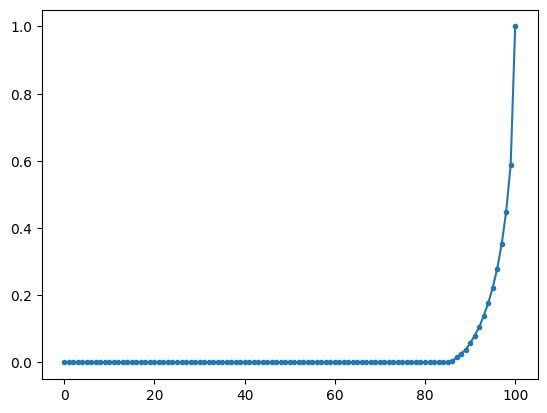

In [34]:
x = np.linspace(0, 100, 101)
sorted_counts = crime_street_segments.sort_values(by="Crime count")["Crime count"]

pct = pd.Series(index=x, data=np.percentile(sorted_counts.cumsum() / sorted_counts.sum(), x))
pct.plot(marker=".")